<a href="https://colab.research.google.com/github/lgkartik/mlmadeeasy/blob/master/flower_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## flower type classification

In [0]:
#importing neccessary package
import numpy as np
import matplotlib.pyplot as plt
import cv2
import keras
import os
import pathlib

In [0]:
#explore the dataset
view_path ='/home/kklg/Desktop/computer_vision_udemy/17-flowers/17_flowers/view_image'

Populating the interactive namespace from numpy and matplotlib


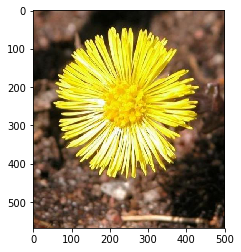

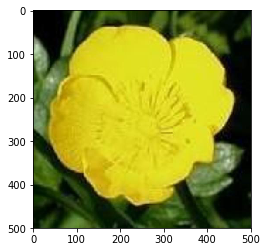

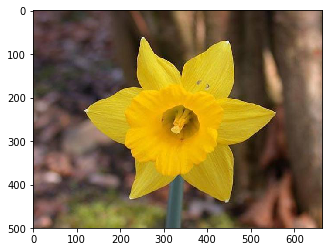

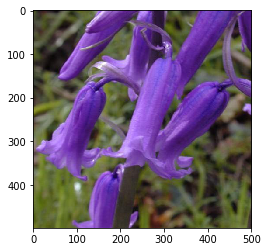

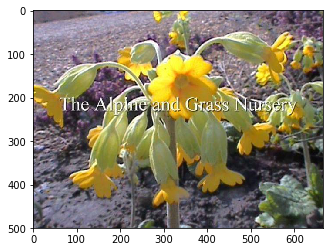

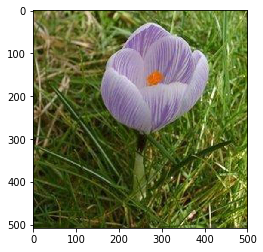

In [0]:
#showing some ofthe image
%pylab inline
import matplotlib.image as mpimg
for file in pathlib.Path(view_path).iterdir():
    img = mpimg.imread(file)
    img = plt.imshow(img)
    plt.show()

In [0]:
img_row,img_col =(64,64)


In [0]:
#building a convutional model 
from keras.models import Sequential
from keras.layers import Conv2D,MaxPooling2D,Dropout,Dense,BatchNormalization,Flatten

In [0]:
model = Sequential()
model.add(Conv2D(32,(3,3),kernel_initializer='uniform',input_shape =(img_row,img_col,3),activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size =(2,2)))

model.add(Conv2D(64,(3,3),kernel_initializer='uniform',activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size =(2,2)))

model.add(Conv2D(128,(3,3),kernel_initializer='uniform',activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size =(2,2)))

model.add(Flatten())

model.add(Dense(500,activation='relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(Dense(17,activation='softmax'))


In [0]:
#dataset preparation
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1.0/255,rotation_range=20,width_shift_range=0.2,height_shift_range=0.2
                                  ,shear_range=0.2,zoom_range=0.2)
test_datagen = ImageDataGenerator(rescale=1.0/255)

In [0]:
train_path ='/home/kklg/Desktop/computer_vision_udemy/17-flowers/17_flowers/train'
test_path ='/home/kklg/Desktop/computer_vision_udemy/17-flowers/17_flowers/validation'

In [0]:
train_datagenerator =train_datagen.flow_from_directory(train_path,target_size =(img_row,img_col),
                                                      class_mode='categorical',batch_size=32,
                                                       interpolation='nearest')
test_datagenerator =test_datagen.flow_from_directory(test_path,target_size =(img_row,img_col),
                                                      class_mode='categorical',batch_size=32,
                                                       interpolation='nearest')

Found 1190 images belonging to 17 classes.
Found 170 images belonging to 17 classes.


In [0]:
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics =['accuracy'])

In [0]:
history = model.fit_generator(train_datagenerator,steps_per_epoch=1190,validation_data=test_datagenerator,
                    validation_steps=170,
                   epochs=20,verbose=1)

Epoch 1/20
1190/1190 [==============================] - 928s 780ms/step - loss: 0.9400 - acc: 0.6924 - val_loss: 3.8083 - val_acc: 0.4289
Epoch 2/20
1190/1190 [==============================] - 905s 760ms/step - loss: 0.3775 - acc: 0.8747 - val_loss: 1.5211 - val_acc: 0.6884
Epoch 3/20
1190/1190 [==============================] - 890s 748ms/step - loss: 0.2319 - acc: 0.9219 - val_loss: 0.7123 - val_acc: 0.7832
Epoch 4/20
1190/1190 [==============================] - 913s 767ms/step - loss: 0.1759 - acc: 0.9408 - val_loss: 0.8168 - val_acc: 0.7948
Epoch 5/20
1190/1190 [==============================] - 909s 763ms/step - loss: 0.1369 - acc: 0.9537 - val_loss: 0.9565 - val_acc: 0.7589
Epoch 6/20
1190/1190 [==============================] - 1179s 991ms/step - loss: 0.1317 - acc: 0.9587 - val_loss: 0.6696 - val_acc: 0.8361
Epoch 7/20
1190/1190 [==============================] - 1240s 1s/step - loss: 0.1163 - acc: 0.9615 - val_loss: 0.7615 - val_acc: 0.8186
Epoch 8/20
1190/1190 [=============

In [0]:
model.save('/home/kklg/Desktop/computer_vision_udemy/17-flowers/17_flowers/flower_classificaion.h5')

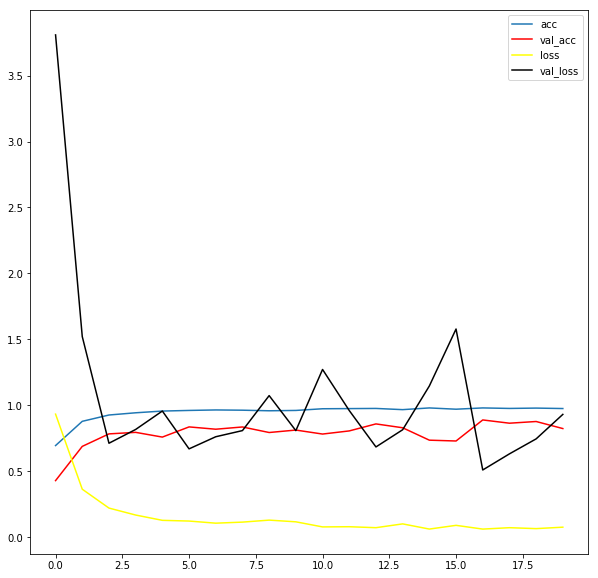

In [0]:
ax,fig = plt.subplots(figsize =(10,10))
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'],'r')
plt.plot(history.history['loss'],'yellow')
plt.plot(history.history['val_loss'],'black')
plt.legend(['acc','val_acc','loss','val_loss'],loc='upper right')
plt.show()


## interpretation
the training loss decreased from 1 to around 0.5 by 10th epoch's.the validation loss is varying in between 0.5 and 1.5

In [0]:
dic = train_datagenerator.class_indices
new_dict = dict([(value, key) for key, value in dic.items()])


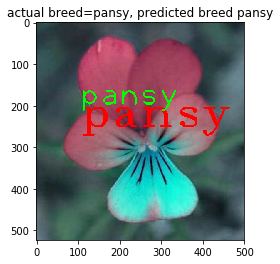

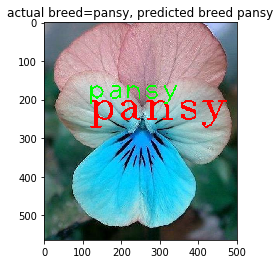

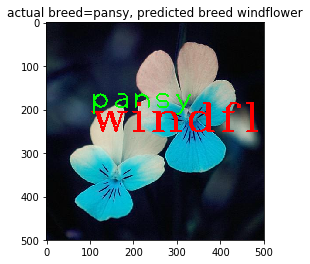

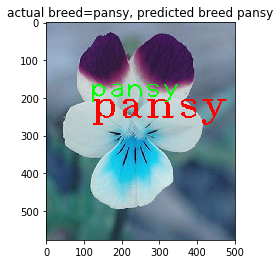

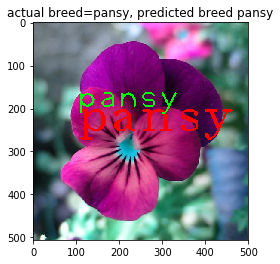

...

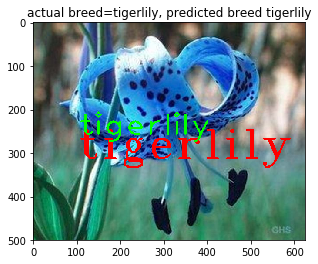

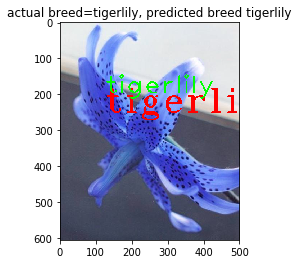

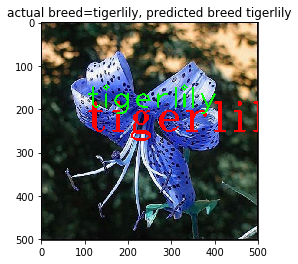

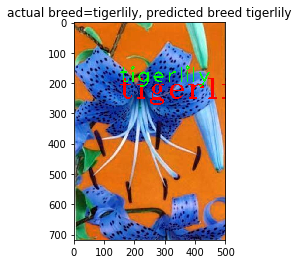

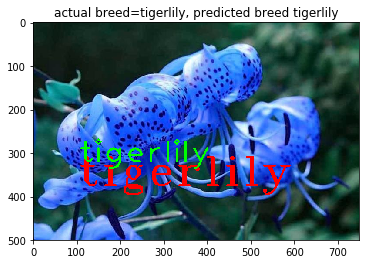

In [0]:
#prediction
#lets predict
test_path ='/home/kklg/Desktop/computer_vision_udemy/17-flowers/17_flowers/validation'
from keras.preprocessing.image import load_img,img_to_array
for folder in os.listdir(test_path):
    for file in pathlib.Path(os.path.join(test_path,folder)).iterdir():
        str_file = str(file)
        image =cv2.imread(str_file)
        x1 = image.shape[0]//5
        y1 =image.shape[1]//2
        y2=y1-50
        x2=x1
        img = load_img(file,target_size =(64,64))
        img = img_to_array(img)
        img = np.reshape(img,[1,img.shape[0],img.shape[1],img.shape[2]])
        img = img/255.0
        y_pred = model.predict_classes(img)
        y_text = new_dict[y_pred[0]]
        cv2.putText(image,y_text,(x1,y1),cv2.FONT_HERSHEY_COMPLEX_SMALL,5,(255,0,0),4)
        cv2.putText(image,folder,(x2,y2),cv2.FONT_HERSHEY_PLAIN,5,(0,255,0),4)
        
        plt.imshow(image)
        plt.title('actual breed='+str(folder)+', predicted breed '+y_text)
        plt.show()
        